<a name="top"> <h1>Airbnb Booking Days Prediction</h1> <a>

<hr style="border:1px solid gray">

#### Table of Contents
1. [Introduction](#1)
2. [Library Import](#2)
3. [Data Import and Basic Preprocessing](#3)
4. [Data Split](#4)
5. [Exploratory Data Analysis (EDA)](#5)
   - 5.1 [Data Overview](#5.1)
   - 5.2 [Numerical Features](#5.2)
     - A) [Drop Useless Numerical Features](#5.2.A)
     - B) [Plot Histograms for Numerical Features](#5.2.B)
     - C) [Plot Scatter Plots for Numerical Features Against 'Days Booked'](#5.2.C)
     - D) [Transformations](#5.2.D)
   - 5.3 [Categorical Features](#5.3)
     - A) [Hand-Pick Useful and Relevant Categorical Features](#5.3.A)
     - B) [Tag Informative Missing Values](#5.3.B)
6. [Preprocessing and Transformations](#6)
7. [Define Functions for Comparing Results](#7)
   - 7.1 [Save and Compare R² Scores for the Models](#7.1)
   - 7.2 [Save and Compare Cross-Validation Results](#7.2)
8. [Baseline Model](#8)
9. [Ridge and Hyperparament Tuning](#9)
10. [Elastic Net and Hyperparament Tuning](#10)
11. [Check Permutation Importance](#11)
12. [More Feature Engineering](#12)
    - 12.1 [Discretize Nights and Availability 30](#12.1)
    - 12.2 [Check Latitude and Longitude Residuals](#12.2)
    - 12.3 [Check Price and Bedrooms Residuals](#12.3)
    - 12.4 [Assembling More Features (More Discretinization and Interaction Terms)](#12.4)
13. [Compare Model Performance After More Feature Engineering](#13)
14. [Non-Linear Model: Random Forest and Hyperparameter Tuning](#14)
15. [Permutation Importance for the Best Model](#15)
16. [Final Prediction](#16)
17. [Insights and Recommendations](#17)
    - 17.1 [Observations from Feature Importance](#17.1)
    - 17.2 [Key Insights](#17.2)
    - 17.3 [Actionable Recommendations](#17.3)
      - A) [For Airbnb Owners in LA](#17.3.A)
      - B) [For Airbnb as A Platform](#17.3.A)

## 1. Introduction<a name="1"></a>
<hr>

**Data Source**: The data is from [Inside Airbnb](https://insideairbnb.com/los-angeles/) and provided extensive information about Airbnb properties listed in Los Angeles, California. The data dictionary is here: [link](https://docs.google.com/spreadsheets/d/1iWCNJcSutYqpULSQHlNyGInUvHg2BoUGoNRIGa6Szc4/edit?gid=1322284596#gid=1322284596)

**Goal**: In this project, instead of going for the most common prediction of listing price, my goal is to **predict the number of days a given Airbnb listing will be booked in the next 30 days**. 

**Challenge**: The dataset involves 70+ features, and it is not clear which features are important for predicting the number of days a listing will be booked. I need to do several rounds of feature engineering to identify the most important features and try to capture both linear and nonlinear relationships.

**Process**:
- I will leverage the insights gained from exploratory data analysis (EDA) to construct the model. This will involve building preprocessing pipeline, feature engineering, trying different models, regularization, model selection, and cross-validation techniques to ensure the model's accuracy and reliability. 

- I only have access to actual booking data for a small subset of listings, which will serve as my training data. So I need to either split the training data into training and validation sets, or use cross-validation to evaluate the model's performance. Then try the best performing model on the test data and report test scores.

- Ultimately, I aim to provide actionable insights that can enhance the understanding of booking patterns and improve decision-making for Airbnb hosts.


## 2. Library Import<a name="1"></a>
<hr>

In [2]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, KBinsDiscretizer, OneHotEncoder, FunctionTransformer
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LinearRegression, Ridge, ElasticNet
from sklearn.model_selection import GridSearchCV
from sklearn.inspection import permutation_importance
from plotnine import ggplot, aes, geom_tile, geom_point, geom_smooth, facet_wrap
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score 

In [3]:
pd.set_option("display.max_columns", 50)
pd.set_option("display.max_rows", 100)

## 3. Data Import, Basic Preprocessing<a name="1"></a>
<hr>

In [4]:
def basic_preprocess(df):
    if df.price.dtype == "O":
        df["price"] = (
            df["price"].str.replace("$", "").str.replace(",", "").astype(float)
        )
    df = df.dropna(subset=["price"])
    if df.host_response_rate.dtype == "O":
        df["host_response_rate"] = (
            df["host_response_rate"].str.replace("%", "").astype(float)
        )
    if df.host_acceptance_rate.dtype == "O":
        df["host_acceptance_rate"] = (
            df["host_acceptance_rate"].str.replace("%", "").astype(float)
        )
    return df


x_df = basic_preprocess(
    pd.read_csv(
        "https://data.insideairbnb.com/united-states/ca/los-angeles/2024-09-04/data/listings.csv.gz"
    )
)

y_df = pd.read_parquet("data/raw/y_train.parquet")

train_df = x_df.merge(y_df, on="id")

outer = x_df.merge(y_df, how="outer", indicator=True)
test_df = outer[(outer._merge == "left_only")].drop("_merge", axis=1)

In [5]:
print(train_df.shape)
print(test_df.shape)

(3729, 76)
(33567, 76)


In [6]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3729 entries, 0 to 3728
Data columns (total 76 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            3729 non-null   int64  
 1   listing_url                                   3729 non-null   object 
 2   scrape_id                                     3729 non-null   int64  
 3   last_scraped                                  3729 non-null   object 
 4   source                                        3729 non-null   object 
 5   name                                          3729 non-null   object 
 6   description                                   3635 non-null   object 
 7   neighborhood_overview                         1839 non-null   object 
 8   picture_url                                   3729 non-null   object 
 9   host_id                                       3729 non-null   i

In [7]:
train_df.head()

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,...,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,days_booked
0,1158417037056953812,https://www.airbnb.com/rooms/1158417037056953812,20240904164210,2024-09-05,city scrape,Lovely High Rise in Ktown,You'll have a great time at this comfortable p...,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,485962662,https://www.airbnb.com/users/show/485962662,Max,2022-11-01,NaN,NaN,a few days or more,30.0,17.0,f,https://a0.muscache.com/im/pictures/user/d7360...,https://a0.muscache.com/im/pictures/user/d7360...,Westlake,2.0,2.0,"['email', 'phone']",...,30,60,90,269,2024-09-05,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,2,2,0,0,NaN,0
1,53405110,https://www.airbnb.com/rooms/53405110,20240904164210,2024-09-05,city scrape,Downtown Loft,NaN,NaN,https://a0.muscache.com/pictures/f0b186c4-2a75...,416339920,https://www.airbnb.com/users/show/416339920,Shaina,2021-08-01,NaN,NaN,NaN,NaN,NaN,f,https://a0.muscache.com/im/pictures/user/1e167...,https://a0.muscache.com/im/pictures/user/1e167...,South Los Angeles,4.0,6.0,['phone'],...,30,60,90,364,2024-09-05,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,4,2,2,0,NaN,0
2,1099697666994383724,https://www.airbnb.com/rooms/1099697666994383724,20240904164210,2024-09-05,city scrape,Chic Apartment in the Heart of Beverly Hills #8,Welcome to our beautifully appointed apartment...,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,367097591,https://www.airbnb.com/users/show/367097591,Aura,2020-09-11,NaN,NaN,within an hour,100.0,91.0,f,https://a0.muscache.com/im/pictures/user/8e3f5...,https://a0.muscache.com/im/pictures/user/8e3f5...,Westlake,7.0,77.0,"['email', 'phone']",...,15,45,75,259,2024-09-05,6,6,0,2024-04-01,2024-07-14,4.83,4.83,4.67,5.0,4.83,4.83,4.67,NaN,t,4,4,0,0,1.14,24
3,1039777404032438158,https://www.airbnb.com/rooms/1039777404032438158,20240904164210,2024-09-05,city scrape,"Blueground | NoHo, walk to restaurants & art","Discover the best of Los Angeles, with this th...",This furnished apartment is located in North H...,https://a0.muscache.com/pictures/prohost-api/H...,107434423,https://www.airbnb.com/users/show/107434423,Blueground,2016-12-16,"New York, NY","We’re Blueground, a global proptech company wi...",within an hour,100.0,96.0,f,https://a0.muscache.com/im/pictures/user/d0ad9...,https://a0.muscache.com/im/pictures/user/d0ad9...,Cambridge,4494.0,4784.0,"['email', 'phone', 'work_email']",...,0,0,0,156,2024-09-05,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,569,569,0,0,NaN,28
4,53633927,https://www.airbnb.com/rooms/53633927,20240904164210,2024-09-05,city scrape,Venice Flower Cottage: Ideal WFH + dry sauna,Welcome to the Flower Cottage Venice - your ve...,Venice is an absolute dreamland. From the gorg...,https://a0.muscache.com/pictures/miso/Hosting-...,265269171,https://www.airbnb.com/users/show/265269171,Tori,2019-05-30,"San Francisco, CA",Texan turned Californian who has been soaking ...,within an hour,100.0,98.0,t,https://a0.muscache.com/im/pictures/user/1930c...,https://a0.muscache.com/im/pictures/user/1930c...,Chino Canyon,5.0,28.0,"['email', 'phone', 'work_email']",...,1,31,58,58,2024-09-05,7,4,0,2022-03-27,2024-07-10,5.00,5.00,5.00,5.0,

## 4. Data Split<a name="1"></a>
<hr>

In [8]:
train, test = train_test_split(train_df, test_size=0.2, random_state=42)

target = 'days_booked'

X_train, y_train = train.drop(columns=[target]), train[target]
X_test, y_test = test.drop(columns=[target]), test[target]

## 5. EDA<a name="1"></a>
<hr>

### 01. Data Overview

In [9]:
print(train.shape)
print(test.shape)

(2983, 76)
(746, 76)


In [10]:
train.head()

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,...,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,days_booked
1832,1093469007814651698,https://www.airbnb.com/rooms/1093469007814651698,20240904164210,2024-09-06,city scrape,Avalon Hideaway,On a hillside just a block and a half from the...,Calle Del Sol is right behind (and above the C...,https://a0.muscache.com/pictures/hosting/Hosti...,46247048,https://www.airbnb.com/users/show/46247048,Craig,2015-10-10,"Redlands, CA",I am 84 years old and mostly retired. My wife ...,within an hour,100.0,97.0,t,https://a0.muscache.com/im/users/46247048/prof...,https://a0.muscache.com/im/users/46247048/prof...,NaN,1.0,1.0,"['email', 'phone']",...,14,34,56,56,2024-09-06,13,13,0,2024-03-17,2024-07-22,4.92,4.92,4.92,4.69,4.92,4.92,4.77,NaN,f,1,1,0,0,2.24,30
3727,1076056030435406530,https://www.airbnb.com/rooms/1076056030435406530,20240904164210,2024-09-05,city scrape,Mini Glam Pad | Near LAX,Soak up the sun & live in luxury with modern a...,NaN,https://a0.muscache.com/pictures/hosting/Hosti...,262298948,https://www.airbnb.com/users/show/262298948,Tammy,2019-05-16,NaN,NaN,within an hour,100.0,100.0,f,https://a0.muscache.com/im/pictures/user/7dd92...,https://a0.muscache.com/im/pictures/user/7dd92...,NaN,5.0,10.0,"['email', 'phone']",...,22,52,82,262,2024-09-05,6,6,0,2024-02-02,2024-07-31,4.33,4.50,4.00,5.00,5.00,4.33,4.00,NaN,t,5,5,0,0,0.83,30
1940,3783358,https://www.airbnb.com/rooms/3783358,20240904164210,2024-09-05,city scrape,Oasis in Venice Beach with a Shaded Patio,This studio - STRICTLY FOR ONE GUEST ONLY - is...,This studio is in a superb location. It is clo...,https://a0.muscache.com/pictures/c2f6e1ad-9cfc...,288128467,https://www.airbnb.com/users/show/288128467,J.A.,2019-08-22,"Los Angeles, CA",My wife Charlotte and I enjoy welcoming visito...,within an hour,100.0,95.0,t,https://a0.muscache.com/im/pictures/user/41108...,https://a0.muscache.com/im/pictures/user/41108...,Venice,5.0,7.0,"['email', 'phone']",...,0,0,0,62,2024-09-05,339,0,0,2015-01-02,2020-02-23,4.92,4.95,4.98,4.97,4.98,4.94,4.78,NaN,f,4,4,0,0,2.88,30
209,1069672792952710414,https://www.airbnb.com/rooms/1069672792952710414,20240904164210,2024-09-05,city scrape,Comfort 2 bed apt Runyon canyon,Take it easy at this unique and tranquil getaw...,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,392789878,https://www.airbnb.com/users/show/392789878,Robert,2021-03-16,NaN,Policy number: HSR21-OO1645,within an hour,99.0,93.0,f,https://a0.muscache.com/im/pictures/user/ffade...,https://a0.muscache.com/im/pictures/user/ffade...,Central LA,25.0,66.0,"['email', 'phone']",...,10,34,64,64,2024-09-05,15,15,2,2024-02-15,2024-08-16,4.80,4.87,4.93,4.87,5.00,5.00,4.80,Exempt,f,14,14,0,0,2.21,30
3374,1167743254396989977,https://www.airbnb.com/rooms/1167743254396989977,20240904164210,2024-09-05,city scrape,Rare Find 2BR Apt in Koreatown,~Welcome to our 2 bd/1 bth suite in the heart ...,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,376818310,https://www.airbnb.com/users/show/376818310,Charie,2020-11-24,NaN,NaN,within an hour,100.0,79.0,f,https://a0.muscache.com/im/pictures/user/602ee...,https://a0.muscache.com/im/pictures/user/602ee...,McManus,23.0

In [11]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2983 entries, 1832 to 3174
Data columns (total 76 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            2983 non-null   int64  
 1   listing_url                                   2983 non-null   object 
 2   scrape_id                                     2983 non-null   int64  
 3   last_scraped                                  2983 non-null   object 
 4   source                                        2983 non-null   object 
 5   name                                          2983 non-null   object 
 6   description                                   2908 non-null   object 
 7   neighborhood_overview                         1453 non-null   object 
 8   picture_url                                   2983 non-null   object 
 9   host_id                                       2983 non-null   int

In [12]:
train.isnull().sum()

id                                                 0
listing_url                                        0
scrape_id                                          0
last_scraped                                       0
source                                             0
name                                               0
description                                       75
neighborhood_overview                           1530
picture_url                                        0
host_id                                            0
host_url                                           0
host_name                                          0
host_since                                         0
host_location                                    743
host_about                                      1405
host_response_time                               341
host_response_rate                               341
host_acceptance_rate                             330
host_is_superhost                             

In [13]:
train.nunique()

id                                              2983
listing_url                                     2983
scrape_id                                          1
last_scraped                                       3
source                                             1
name                                            2969
description                                     2701
neighborhood_overview                           1375
picture_url                                     2973
host_id                                         2336
host_url                                        2336
host_name                                       1577
host_since                                      1794
host_location                                    202
host_about                                      1215
host_response_time                                 4
host_response_rate                                47
host_acceptance_rate                              81
host_is_superhost                             

### 02. Numercial Features

#### A) Drop useless numerical features

Some numerical features contains useless information for prediction, such as id, columns with only 0 or 1 feature (`calendar_updated`), or the target column (`days_booked`). We need to drop these columns in the training set.


In [14]:
num = train.select_dtypes(include=['float64', 'int64']).drop(columns=['id', 'host_id', 'scrape_id', 'calendar_updated', 'days_booked'])

#### B) Plot histograms for numerical features

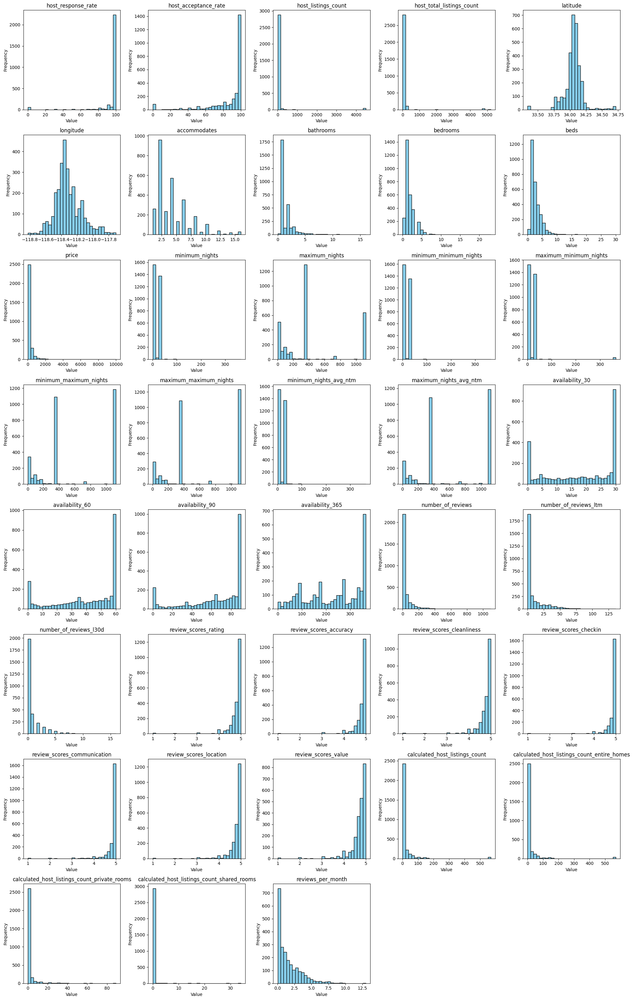

In [15]:
num_features = num.columns
n_features = len(num_features)

# Calculate number of rows and columns needed
n_cols = 5
n_rows = (n_features // n_cols) + (n_features % n_cols > 0)  

# Plot histograms for numerical features
plt.figure(figsize=(20, n_rows * 4))
for i, column in enumerate(num_features, 1):
    plt.subplot(n_rows, n_cols, i)  
    plt.hist(num[column], bins=30, color='skyblue', edgecolor='black')
    plt.title(column)
    plt.xlabel('Value')
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

#### C) Plot scatter plots for numerical features against 'days_booked'

Linear regression could not be computed for host_response_rate. Skipping this feature. ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  5 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value

Linear regression could not be computed for host_acceptance_rate. Skipping this feature.
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  5 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
Linear regression could not be computed for bathrooms. S

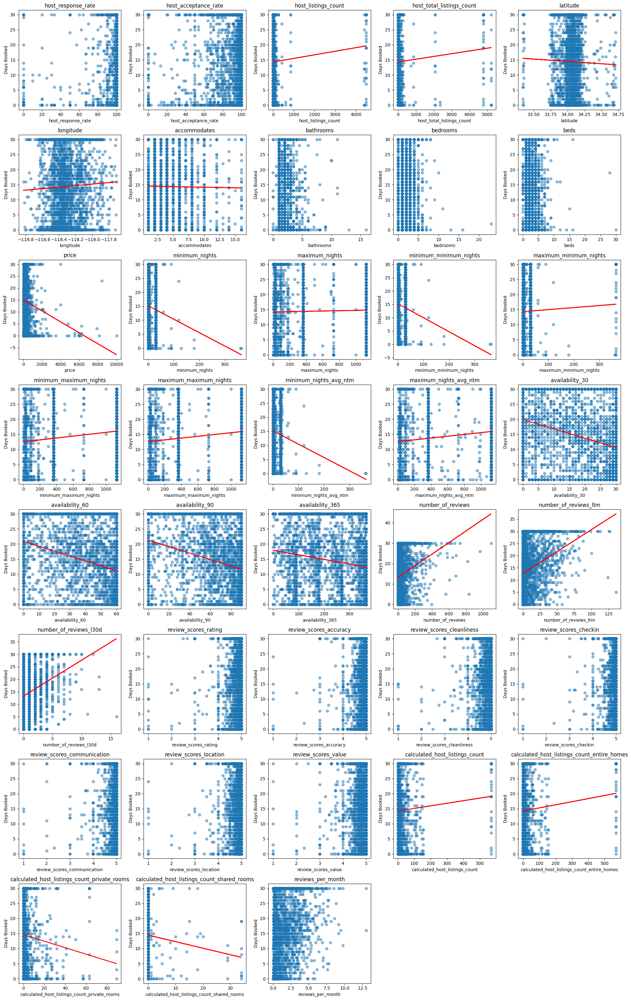

In [16]:
# Plot scatter plots for numerical features against 'days_booked'

plt.figure(figsize=(20, n_rows * 4))  # Increase figure size for scatter plots
for i, column in enumerate(num_features, 1):
    plt.subplot(n_rows, n_cols, i)  # Create subplots for scatter plots
    plt.scatter(num[column], train['days_booked'], alpha=0.5)
    
    # Calculate linear regression line with error handling
    try:
        m, b = np.polyfit(num[column], train['days_booked'], 1)  # m is slope, b is intercept
        plt.plot(num[column], m * num[column] + b, color='red', linewidth=2)  # Plot the line
    except np.linalg.LinAlgError:
        print(f"Linear regression could not be computed for {column}. Skipping this feature.")
    
    plt.title(f'{column}')
    plt.xlabel(column)
    plt.ylabel('Days Booked')

plt.tight_layout()
plt.show()

#### D) Transformations

Upon analyzing the histograms of the numercial features, we notice some features need special transformation:

1. `beds`, `bedrooms` and `bathrooms` only have a few values. We can treat them as **discrete** in later transformation 

In [17]:
discrete = ['beds', 'bedrooms', 'bathrooms']

2. Some features (mainly maximum and minimum nights features) exhibit unusual patterns, such as clustering and outliers. Based on common sense, we can **clamp** them to 30 and 365 days in later transformation.

In [18]:
clamp_min = ["minimum_nights",
                "minimum_nights_avg_ntm",
                "minimum_minimum_nights",
                "maximum_minimum_nights"]

clamp_max = ["maximum_nights",
                "maximum_nights_avg_ntm",
                "minimum_maximum_nights",
                "maximum_maximum_nights"]

3. `price`, reviews and listings count features have long tails to the right (left skewed). We will do **log transformation** on them to compress the range of the data, making the distribution more symmetric and closer to a normal distribution.

In [19]:
log = [
    "price",
    "number_of_reviews",
    "number_of_reviews_ltm",
    "calculated_host_listings_count",
    "host_listings_count",
    "host_total_listings_count",
    "calculated_host_listings_count_entire_homes"
]


For the rest of numerical features, we need to standardize them to have a mean of 0 and a SD of 1, and deal with missing values.

### 03. Categorical Features

#### A) Hand-pick useful and relevant cat features

`property_type`, `room_type`, `neighbourhood_cleansed`, `instant_bookable`, `host_is_superhost`, `host_identity_verified`, `host_has_profile_pic`, `host_response_time`, `host_verifications` are picked since they contain more than 1 values, are not textual, and are not too complicated to deal with (not like `amenities`)

In [20]:
cat = [
    "neighbourhood_cleansed",
    "room_type",
    "property_type",
    "instant_bookable",
    "host_is_superhost",
    "host_identity_verified",
    "host_has_profile_pic",
    "host_response_time",
    "host_verifications"
]

#### B) Tag informative missing values

The missing values for features like `neighborhood_overview`, `last_review`, and `host_about` can be informative. For instance, listings with no recent reviews may be perceived as less trustworthy or less popular, which could affect their booking performance.

In [21]:
missing_indicator = ["neighborhood_overview", "last_review", "host_about"]

## 6. Preprocessing and Transformations<a name="1"></a>
<hr>

We assemble the analysis and necessary transformations discussed in the EDA together, to form a basic transformation pipeline.

In [22]:
# Step 1: Define the numerical transformer
num_transformer = Pipeline(steps=[
    ('impute', SimpleImputer(strategy='constant', fill_value=0)),  
    ('scale', StandardScaler())  
])

# Step 2: Define the discrete transformer
discrete_transformer = Pipeline(steps=[
    ('impute', SimpleImputer(strategy='mean')),  
    ('binner', KBinsDiscretizer(n_bins=5, encode='onehot'))  
])

# Step 3: Define the clamp transformer
clamp_min_transformer = Pipeline(steps=[
    ('clamp_min', FunctionTransformer(lambda x: np.clip(x, 0, 30), validate=False)),  # Clamp within 30 days
])

clamp_max_transformer = Pipeline(steps=[
    ('clamp_max', FunctionTransformer(lambda x: np.clip(x, 0, 365), validate=False))  # Clamp within 365 days
])

# Step 4: Define the log transformer
log_transformer =  Pipeline(steps=[
                ("log", FunctionTransformer(np.log1p)),
                ("standardize", StandardScaler())
])

# Step 5: Define the categorical transformer
cat_transformer = Pipeline(steps=[
    ('impute', SimpleImputer(strategy='constant', fill_value='missing')),  # Fill missing values
    ('onehot', OneHotEncoder(handle_unknown='ignore', drop='first', min_frequency=10))  # One-hot encode
])

# Step 6: Define the missing indicator transformer
missing_indicator_transformer = Pipeline(steps=[
    ('indicator', FunctionTransformer(lambda x: x.notnull(), validate=False))  # Create missing indicators
])

# Step 7: Combine all transformers into a single ColumnTransformer
transformation_1 = ColumnTransformer(
    transformers=[
        ('num', num_transformer, list(set(num) - set(clamp_min) - set(clamp_max))),
        ('discrete', discrete_transformer, discrete),
        ('clamp_min_nights', clamp_min_transformer, clamp_min),
        ('clamp_max_nights', clamp_max_transformer, clamp_max),
        ('log', log_transformer, log),
        ('cat', cat_transformer, cat),
        ('missing_indicator', missing_indicator_transformer, missing_indicator)  # Add missing indicators
    ]
)

In [22]:
# check out number of features after transformation
print(transformation_1.fit_transform(train).shape)

(2983, 182)


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 1 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 2 are removed. Consider decreasing the number of bins.
  warnings.warn(


## 7. Define Functions for Comparing Results<a name="1"></a>
<hr>

Define functions to save and compare results.

In [23]:
datasets = {"train": train, "test": test}

### 01. Save and compare R² scores for the models on the provided datasets.

In [24]:
def save_r2(model, datasets, results, model_name):
    """
    model : scikit-learn model
        The model to evaluate.
    datasets : dict
        A dictionary containing the datasets (train and test).
    results : dict
        A dictionary to store the R² scores for each model.
    model_name : str
        The name of the model to use as a key in the results dictionary.
    """
    r2_scores = {}
    for name, data in datasets.items():
        r2_score = model.score(data.drop("days_booked", axis=1), data["days_booked"])
        r2_scores[name] = r2_score

    # Store the R² scores in the results dictionary
    results[model_name] = r2_scores

### 02. Save and compare cross-validation results for different models.

In [25]:
def save_cv(cv, cv_results, model_name):
    """
    cv : GridSearchCV object
        The fitted GridSearchCV object containing cross-validation results.
    cv_results : dict
        A dictionary to store the mean test score, standard deviation of the test score, and parameters.
    model_name : str
        The name of the model to use as a key in the cv_results dictionary.
    """
    cvdf = pd.DataFrame(cv.cv_results_)
    best = cvdf.loc[cvdf.mean_test_score.argmax(), ["mean_test_score", "std_test_score", "params"]]
    best["std_test_score"] = best["std_test_score"] / np.sqrt(cv.n_splits_)
    
    # Save the results to the cv_results dictionary
    cv_results[model_name] = {
        "mean_test_score": best["mean_test_score"],
        "std_test_score": best["std_test_score"],
        "params": best["params"]
    }

Initialize empty dictionaries to store model results and cross-validation results.

In [26]:
results = {}  

cv_results = {}

## 8. Baseline Model<a name="1"></a>
<hr>

Start with building a baseline linear model and save the results.

In [28]:
linreg = Pipeline(
    [
        ("trans", transformation_1),
        ("linear_reg", LinearRegression()),
    ]
)

linreg.fit(X_train, y_train)

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 1 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 2 are removed. Consider decreasing the number of bins.
  warnings.warn(


Pipeline(steps=[('trans',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('impute',
                                                                   SimpleImputer(fill_value=0,
                                                                                 strategy='constant')),
                                                                  ('scale',
                                                                   StandardScaler())]),
                                                  ['review_scores_communication',
                                                   'host_total_listings_count',
                                                   'bedrooms',
                                                   'review_scores_location',
                                                   'longitude',
                                                   'availability_365',
                                                   'review_scores_rating',
                                                   'beds', 'host_response_rate',
                                                   'revi...
                                                   'room_type', 'property_type',
                                                   'instant_bookable',
                                                   'host_is_superhost',
                                                   'host_identity_verified',
                                                   'host_has_profile_pic',
                                                   'host_response_time',
                                                   'host_verifications']),
                                                 ('missing_indicator',
                                                  Pipeline(steps=[('indicator',
                                                                   FunctionTransformer(func=<function <lambda> at 0x28d2f2520>))]),
                                                  ['neighborhood_overview',
                                                   'last_review',
                                                   'host_about'])])),
                ('linear_reg', LinearRegression())])

In [29]:
save_r2(linreg, datasets, results, "linear_reg")

pd.DataFrame(results)

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


,linear_reg
train,0.284392
test,0.181947


There is a big gap (~10%) between train and test r2, which indicates overfitting. We can try to improve the model by regularizing it.

## 9. Ridge Regularization and Hyperparament Tuning<a name="1"></a>
<hr>

In [36]:
# Define the pipeline with Ridge regression
ridge_pipe = Pipeline(
    [
        ("trans", transformation_1),
        ("ridge", Ridge()),  
    ]
)

# Define the parameter grid for alpha (regularization strength)
param_grid = {
    "ridge__alpha": np.logspace(-4, 4, 30) 
}

# Set up GridSearchCV
ridge = GridSearchCV(
    ridge_pipe,
    param_grid,
    cv=20,  # set folds to maximum to reduce variance
    scoring='r2',  
    n_jobs=-1  
)

# Fit the model
ridge.fit(X_train, y_train)

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 1 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 2 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_d

GridSearchCV(cv=20,
             estimator=Pipeline(steps=[('trans',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('impute',
                                                                                          SimpleImputer(fill_value=0,
                                                                                                        strategy='constant')),
                                                                                         ('scale',
                                                                                          StandardScaler())]),
                                                                         ['review_scores_value',
                                                                          'review_scores_cleanliness',
                                                                          'host_listings_count',
                                                                          'beds',
                                                                          'calculated_host_listings_count',
                                                                          'accommodates',
                                                                          'availability_30',
                                                                          'calcul...
       1.26896100e-03, 2.39502662e-03, 4.52035366e-03, 8.53167852e-03,
       1.61026203e-02, 3.03919538e-02, 5.73615251e-02, 1.08263673e-01,
       2.04335972e-01, 3.85662042e-01, 7.27895384e-01, 1.37382380e+00,
       2.59294380e+00, 4.89390092e+00, 9.23670857e+00, 1.74332882e+01,
       3.29034456e+01, 6.21016942e+01, 1.17210230e+02, 2.21221629e+02,
       4.17531894e+02, 7.88046282e+02, 1.48735211e+03, 2.80721620e+03,
       5.29831691e+03, 1.00000000e+04])},
             scoring='r2')

In [31]:
save_r2(ridge, datasets, results, "ridge")
pd.DataFrame(results)

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


,linear_reg,ridge
train,0.284392,0.246037
test,0.181947,0.223522


In [32]:
save_cv(ridge, cv_results, "ridge")
pd.DataFrame(cv_results)

,ridge
mean_test_score,0.216175
std_test_score,0.010494
params,{'ridge__alpha': 417.53189365604004}


By comparing the ridge and linear model, we can see that ridge regularization reduces the gap between train and test r2, and improves the performance on the test set.

## 10. Elastic Net and Hyperparament Tuning<a name="1"></a>
<hr>

Try elastic net regularization to see if it can improve the model performance. Elastic net combines the advantages of ridge and lasso regularization, has more flexibility to select important features, and has more parameters to tune.

In [33]:
# Define the pipeline with Elastic Net regression
elastic_net_pipe = Pipeline(
    [
        ("trans", transformation_1),
        ("elastic_net", ElasticNet()),  
    ]
)

# Define the parameter grid for alpha (regularization strength) and l1_ratio
param_grid = {
    "elastic_net__alpha": np.logspace(-4, 4, 30),  # Regularization strength
    "elastic_net__l1_ratio": np.linspace(0, 1, 10)  # Mix ratio between L1 and L2
}

# Set up GridSearchCV
elastic_net = GridSearchCV(
    elastic_net_pipe,
    param_grid,
    cv=20,  
    scoring='r2',  
    n_jobs=-1  
)

# Fit the model
elastic_net.fit(X_train, y_train)

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 1 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 2 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_d

GridSearchCV(cv=20,
             estimator=Pipeline(steps=[('trans',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('impute',
                                                                                          SimpleImputer(fill_value=0,
                                                                                                        strategy='constant')),
                                                                                         ('scale',
                                                                                          StandardScaler())]),
                                                                         ['review_scores_communication',
                                                                          'host_total_listings_count',
                                                                          'bedrooms',
                                                                          'review_scores_location',
                                                                          'longitude',
                                                                          'availability_365',
                                                                          'review_scores_rating',
                                                                          'bed...
       2.59294380e+00, 4.89390092e+00, 9.23670857e+00, 1.74332882e+01,
       3.29034456e+01, 6.21016942e+01, 1.17210230e+02, 2.21221629e+02,
       4.17531894e+02, 7.88046282e+02, 1.48735211e+03, 2.80721620e+03,
       5.29831691e+03, 1.00000000e+04]),
                         'elastic_net__l1_ratio': array([0.        , 0.11111111, 0.22222222, 0.33333333, 0.44444444,
       0.55555556, 0.66666667, 0.77777778, 0.88888889, 1.        ])},
             scoring='r2')

In [34]:
save_r2(elastic_net, datasets, results, "elastic_net")
pd.DataFrame(results)

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


,linear_reg,ridge,elastic_net
train,0.284392,0.246037,0.241600
test,0.181947,0.223522,0.225277


In [35]:
save_cv(elastic_net, cv_results, "elastic_net")
pd.DataFrame(cv_results)

,ridge,elastic_net
mean_test_score,0.216175,0.216902
std_test_score,0.010494,0.010908
params,{'ridge__alpha': 417.53189365604004},"{'elastic_net__alpha': 0.1082636733874054, 'el..."


The Elastic Net model has a slightly better performance on the test set compared to Ridge, and it also has a smaller train test gap than Ridge. This suggests that Elastic Net may generalize better to unseen data than Ridge in this specific case.

This is because:
- **Ridge Regression** applies L2 regularization, which tends to **shrink the coefficients but does not set any to zero**. This can be beneficial when dealing with multicollinearity but may not perform as well if some features are irrelevant.
- **Elastic Net** combines both L1 and L2 regularization, allowing it to perform **feature selection (by setting some coefficients to zero)** while also shrinking others. This can lead to better generalization, especially in cases where there are many features, some of which may be irrelevant.

## 11. Check Permutation Importance<a name="1"></a>
<hr>

Even though we achieved a pretty decent R^2 of 22.5%, we may want to keep improving the model performance. We can check out which are the most important features by applying permutation importance, and decide what we wanna do with these important features. 

In [36]:
# Calculate permutation importance
perm_importance = permutation_importance(
    ridge, 
    X_train, 
    y_train, 
    n_repeats=30,  # Number of times to permute a feature
    random_state=0, 
    n_jobs=-1  
)

# Create a DataFrame to hold feature names and their corresponding importances
importance_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': perm_importance.importances_mean,
    'Std': perm_importance.importances_std
})

# Sort the DataFrame by importance
importance_df = importance_df.sort_values(by='Importance', ascending=False)

# Display the top 10 most important features
print(importance_df.head(10))


                                        Feature  Importance       Std
47                       minimum_nights_avg_ntm    0.100062  0.007512
41                               minimum_nights    0.070024  0.005648
57                        number_of_reviews_ltm    0.035846  0.004496
44                       maximum_minimum_nights    0.034712  0.004229
48                       maximum_nights_avg_ntm    0.030892  0.003808
51                              availability_30    0.020014  0.002851
46                       maximum_maximum_nights    0.013924  0.002553
45                       minimum_maximum_nights    0.010193  0.001982
16                           host_response_rate    0.008854  0.002199
71  calculated_host_listings_count_entire_homes    0.007233  0.001941


## 12. More Feature Engineering<a name="1"></a>
<hr>

### 01. Discretize Nights and Availability 30

We want to introduce more nonlinearality. Given the importance scores of the features related to **nights** and **availability_30**, applying more discretization to these features could enhance the model's ability to capture relevant patterns and improve overall performance. 

In [37]:
discretize_2 = [
    "minimum_nights_avg_ntm",
    "minimum_nights",
    "maximum_minimum_nights",
    "maximum_nights_avg_ntm",
    "availability_30",
    "maximum_maximum_nights",
    "minimum_maximum_nights"
]

### 02. Check Latitude and Longtitude Residuals

We can check latitude and longtitude's **residuals** (differences between the actual data and the prediction results) to understand how well the model is fitting the data. 
- Ideally, residuals should be randomly distributed **around zero**, indicating that the model captures the underlying patterns in the data without systematic bias.
- If the residuals are large and show a pattern related to a feature, it may suggest that the feature is not adequately capturing the relationship with the target variable. Then we need to do more feature engineering to better capture the relationship.

In [37]:
train["preds"] = ridge.predict(X_train)
train["residuals"] = ridge.predict(X_train) - y_train

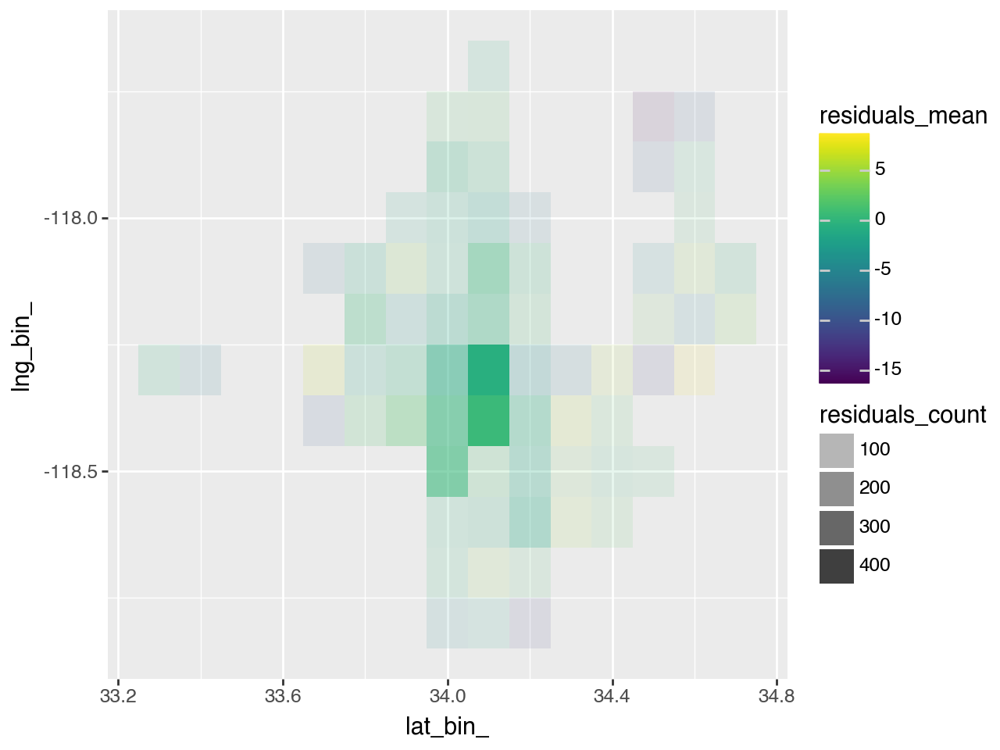

In [42]:
# Latlng are highly nonlinear, so should expect some improvement from this
by_latlng = (
    train.assign(lat_bin=np.round(train.latitude, 1), lng_bin=np.round(train.longitude, 1))[
        ["lat_bin", "lng_bin", "residuals"]
    ]
    .groupby(["lat_bin", "lng_bin"])
    .aggregate(["mean", "count"])
    .reset_index()
)

# by_latlng = by_latlng[by_latlng[("residuals", "count")] > 10]
by_latlng.columns = by_latlng.columns.map("_".join)

(
    ggplot(
        by_latlng,
        aes(
            x="lat_bin_",
            y="lng_bin_",
            fill=("residuals_mean"),
            alpha=("residuals_count"),
        ),
    )
    + geom_tile()
).show()

### 03. Check Price and Bedrooms Residuals

We can check the residuals between price and bedrooms to see if there is a nonlinear relationship between them.

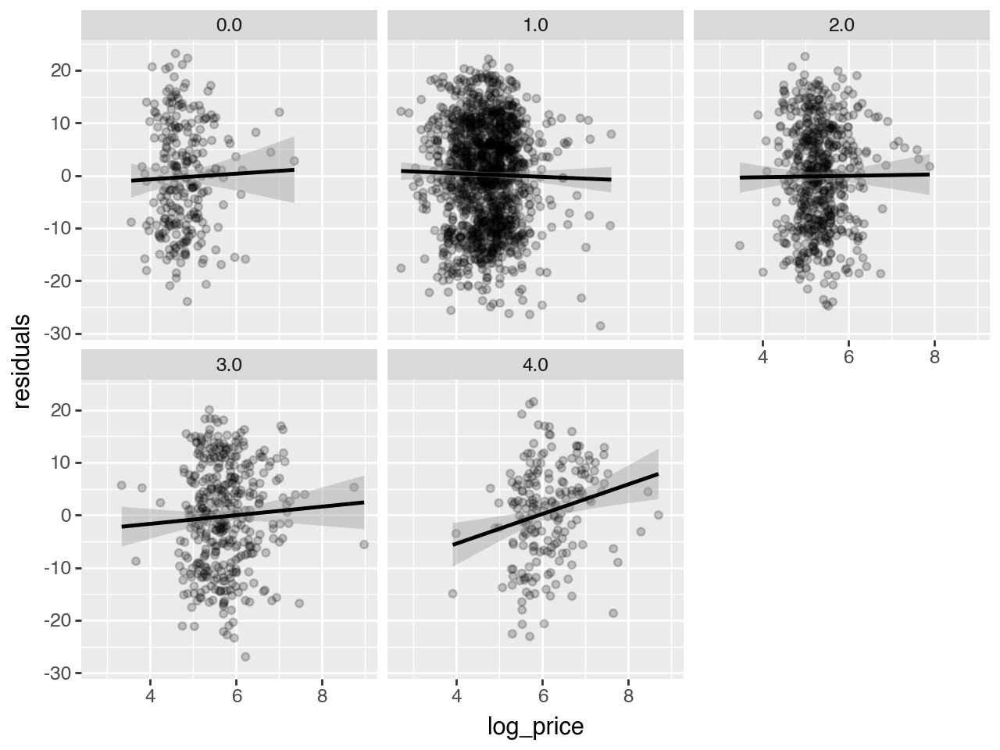

In [43]:
(ggplot(
        train.assign(log_price=np.log(train.price))[train["bedrooms"] < 5],
        aes(x="log_price", y="residuals"),
    )
    + geom_point(alpha=0.2)
    + facet_wrap("~bedrooms")
    + geom_smooth()
    # + xlim((0, 1000))
).show()

### 04. Assembling More Features (Discretize Nights, Lat-Long Interaction, Price-Bedrooms Interaction)

From the residual plots, the residuals are more or less centered around 0. We decide to add interaction terms anyway since intuitively they have a non-linear relationship. We can compare the model's performance after more feature engineering to see if there is an improment.

In [40]:
# Step 1: Define the new discretization transformer for additional features
discretize_2_transformer = Pipeline(
    steps=[
        ("impute", SimpleImputer(strategy='mean')),  # Impute missing values
        ("binner", KBinsDiscretizer(n_bins=5, encode='onehot'))  # Discretize the features
    ]
)

# Step 2: Define the interaction transformer for latitude and longitude
lat_long_interaction_transformer = Pipeline(
    steps=[
        ("discretize", KBinsDiscretizer(n_bins=6)),
        ("poly", PolynomialFeatures(degree=2, interaction_only=True)),
    ]
)

# Step 3: Define the interaction transformer for price and bedrooms
price_bedroom_interaction_transformer = Pipeline(
    steps=[
        ("trans", ColumnTransformer(
            transformers=[
                ("trans",
                Pipeline([("impute", SimpleImputer(strategy='constant', fill_value=-1)),
                ("onehot", KBinsDiscretizer(n_bins=6))]),
                ["bedrooms"]),
                ("log", 
                 Pipeline([
                ("log", FunctionTransformer(np.log1p)),
                ("standardize", StandardScaler())]), 
                ["price"])
            ],
            remainder='passthrough'
        )),
        ("poly", PolynomialFeatures(degree=2, interaction_only=True)),
    ]
)

# Step 4: Create a new ColumnTransformer called transformation_2
transformation_2 = ColumnTransformer(
    transformers=[
        ('num', num_transformer, list(set(num) - set(clamp_min) - set(clamp_max))),
        ('discrete', discrete_transformer, discrete),
        ('clamp_min_nights', clamp_min_transformer, clamp_min),
        ('clamp_max_nights', clamp_max_transformer, clamp_max),
        ('log', log_transformer, log),
        ('cat', cat_transformer, cat),
        ('missing_indicator', missing_indicator_transformer, missing_indicator),
        ('discretize_2', discretize_2_transformer, discretize_2), # add more discretization
        ('lat_long', lat_long_interaction_transformer, ['latitude', 'longitude']),  # Add lat-lng interaction
        ('price_bedroom', price_bedroom_interaction_transformer, ['price', 'bedrooms']),  # Add price-bedroom interaction
    ]
)


## 13. Compare Model Performance After More Feature Engineering<a name="1"></a>
<hr>

Apply elastic net regularization to the new transformation pipeline and compare the results.

In [41]:
# Define the pipeline with Elastic Net regression
elastic_net_pipe = Pipeline(
    [
        ("trans", transformation_2),
        ("elastic_net", ElasticNet()),  
    ]
)

# Define the parameter grid for alpha (regularization strength) and l1_ratio
param_grid = {
    "elastic_net__alpha": np.logspace(-4, 4, 30),  # Regularization strength
    "elastic_net__l1_ratio": np.linspace(0, 1, 10)  # Mix ratio between L1 and L2
}

# Set up GridSearchCV
elastic_net_2 = GridSearchCV(
    elastic_net_pipe,
    param_grid,
    cv=20,  
    scoring='r2',  
    n_jobs=-1  
)

# Fit the model
elastic_net_2.fit(X_train, y_train)

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 1 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 2 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_d

GridSearchCV(cv=20,
             estimator=Pipeline(steps=[('trans',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('impute',
                                                                                          SimpleImputer(fill_value=0,
                                                                                                        strategy='constant')),
                                                                                         ('scale',
                                                                                          StandardScaler())]),
                                                                         ['review_scores_communication',
                                                                          'host_total_listings_count',
                                                                          'bedrooms',
                                                                          'review_scores_location',
                                                                          'longitude',
                                                                          'availability_365',
                                                                          'review_scores_rating',
                                                                          'bed...
       2.59294380e+00, 4.89390092e+00, 9.23670857e+00, 1.74332882e+01,
       3.29034456e+01, 6.21016942e+01, 1.17210230e+02, 2.21221629e+02,
       4.17531894e+02, 7.88046282e+02, 1.48735211e+03, 2.80721620e+03,
       5.29831691e+03, 1.00000000e+04]),
                         'elastic_net__l1_ratio': array([0.        , 0.11111111, 0.22222222, 0.33333333, 0.44444444,
       0.55555556, 0.66666667, 0.77777778, 0.88888889, 1.        ])},
             scoring='r2')

In [42]:
save_r2(elastic_net_2, datasets, results, "elastic_net_2")
pd.DataFrame(results)

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 2] during transform. These unknown categories will be encoded as all zeros


,linear_reg,ridge,elastic_net,elastic_net_2
train,0.284392,0.246037,0.241600,0.251292
test,0.181947,0.223522,0.225277,0.223712


In [43]:
save_cv(elastic_net_2, cv_results, "elastic_net_2")
pd.DataFrame(cv_results)

,ridge,elastic_net,elastic_net_2
mean_test_score,0.216175,0.216902,0.219403
std_test_score,0.010494,0.010908,0.010438
params,{'ridge__alpha': 417.53189365604004},"{'elastic_net__alpha': 0.1082636733874054, 'el...","{'elastic_net__alpha': 0.20433597178569418, 'e..."


The model performance after more feature engineering is not better on the test set, and the gap between train and test r2 is even bigger than the best model before more feature engineering. This could be due to the fact that the new features are not important for the model.

So we should stick to "transformation_1" instead of "transformation_2" for future models.

## 14. Non-linear Model: Random Forest and Hyperparameter Tuning<a name="1"></a>
<hr>

The linear model after elastic net regularization already shows a significant improvement of performance on test set and reduction of overfitting. We still wanna try out nonlinear models like random forest because:

- **Handling Non-Linearity**: Nonlinear models capture complex, non-linear relationships without needing explicit interaction terms.
- **Robustness to Outliers**: Nonlinear models are less sensitive to outliers compared to linear models, which can skew coefficients.
- **Feature Importance**: Random forest provides built-in measures of feature importance, helping identify key predictors.
- **Reduced Risk of Overfitting**: Combines predictions from multiple trees, reducing overfitting risk compared to single models.

In [23]:
# Step 1: Define the pipeline with Random Forest regression
rf_pipeline = Pipeline(
    [
        ("trans", transformation_1),  # Use the existing transformation_1
        ("rf", 
         RandomForestRegressor(
             n_estimators=200,
                max_depth=10,
                n_jobs=-1))  # Random Forest model
    ]
)

# Step 2: Define the parameter grid for hyperparameter tuning
param_grid = {
    #"rf__n_estimators": [100, 200, 300],  # Number of trees in the forest
    "rf__max_depth": [5, 10, 20, 30],  # Maximum depth of the tree
    #"rf__min_samples_split": [2, 5, 10],  # Minimum number of samples required to split an internal node
    #"rf__min_samples_leaf": [1, 2, 4],  # Minimum number of samples required to be at a leaf node
    "rf__max_features": [0.05, 0.1, 0.2, 0.5]  # Number of features to consider when looking for the best split
}

# Step 3: Set up GridSearchCV
rf = GridSearchCV(
    rf_pipeline,
    param_grid,
    cv=20,  # 5-fold cross-validation
    scoring='r2',  # Use R² as the scoring metric
    n_jobs=-1  # Use all available cores
)

# Step 4: Fit the model
rf.fit(X_train, y_train)

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 1 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 2 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_discretization.py:307: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_d

GridSearchCV(cv=20,
             estimator=Pipeline(steps=[('trans',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('impute',
                                                                                          SimpleImputer(fill_value=0,
                                                                                                        strategy='constant')),
                                                                                         ('scale',
                                                                                          StandardScaler())]),
                                                                         ['review_scores_value',
                                                                          'review_scores_cleanliness',
                                                                          'host_listings_count',
                                                                          'beds',
                                                                          'calculated_host_listings_count',
                                                                          'accommodates',
                                                                          'availability_30',
                                                                          'calcul...
                                                                          'host_verifications']),
                                                                        ('missing_indicator',
                                                                         Pipeline(steps=[('indicator',
                                                                                          FunctionTransformer(func=<function <lambda> at 0x2912d4fe0>))]),
                                                                         ['neighborhood_overview',
                                                                          'last_review',
                                                                          'host_about'])])),
                                       ('rf',
                                        RandomForestRegressor(max_depth=10,
                                                              n_estimators=200,
                                                              n_jobs=-1))]),
             n_jobs=-1,
             param_grid={'rf__max_depth': [5, 10, 20, 30],
                         'rf__max_features': [0.05, 0.1, 0.2, 0.5]},
             scoring='r2')

In [45]:
save_r2(rf, datasets, results, "rf")
pd.DataFrame(results)

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 2] during transform. These unknown categories will be encoded as all zeros


,linear_reg,ridge,elastic_net,elastic_net_2,rf
train,0.284392,0.246037,0.241600,0.251292,0.580813
test,0.181947,0.223522,0.225277,0.223712,0.254365


In [46]:
save_cv(rf, cv_results, "rf")
pd.DataFrame(cv_results)

,ridge,elastic_net,elastic_net_2,rf
mean_test_score,0.216175,0.216902,0.219403,0.229249
std_test_score,0.010494,0.010908,0.010438,0.01124
params,{'ridge__alpha': 417.53189365604004},"{'elastic_net__alpha': 0.1082636733874054, 'el...","{'elastic_net__alpha': 0.20433597178569418, 'e...","{'rf__max_depth': 10, 'rf__max_features': 0.1}"


The testing R² score for Random Forest is ~25%, which is higher than the other models but also indicates a notable drop from the training score. This discrepancy suggests that the model may be **overfitting** the training data.

We can use methods such as limiting tree depth, reducing number of leaves, limiting number of features, and increasing minimum samples for splitting to mitigate overfitting and improve the model's ability to generalize to new data.

After preprocessing, building transformation pipeline, several rounds of feature engineering, applying regularization and trying different models, we finally improved the R² score on the test set from 18% to 25%. A significant improvement! Now we can check the feature importance from the best model to see which features are most important for the model.

## 15. Permutation Importance for the Best Model<a name="1"></a>
<hr>

In [ ]:
# Calculate permutation importance
perm_importance = permutation_importance(
    rf, 
    X_train, 
    y_train, 
    n_repeats=30,  # Number of times to permute a feature
    random_state=0, 
    n_jobs=-1  
)

# Create a DataFrame to hold feature names and their corresponding importances
importance_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': perm_importance.importances_mean,
    'Std': perm_importance.importances_std
})

# Sort the DataFrame by importance
importance_df = importance_df.sort_values(by='Importance', ascending=False)

In [45]:
print(importance_df)

                                         Feature  Importance       Std
56                             number_of_reviews    0.017971  0.005490
57                         number_of_reviews_ltm    0.017780  0.005276
52                               availability_60    0.013940  0.004560
53                               availability_90    0.011775  0.003820
51                               availability_30    0.008913  0.003280
74                             reviews_per_month    0.008624  0.003979
41                                minimum_nights    0.005177  0.001427
71   calculated_host_listings_count_entire_homes    0.004620  0.001997
67                           review_scores_value    0.004369  0.002301
54                              availability_365    0.004075  0.002206
65                   review_scores_communication    0.004058  0.002453
64                         review_scores_checkin    0.003777  0.002415
66                        review_scores_location    0.003672  0.002741
40    

## 16. Final Prediction<a name="1"></a>
<hr>

In [26]:
predictions = rf.predict(X_test)
r2 = r2_score(y_test, predictions)
print("R² Score:", r2)

R² Score: 0.24822241842125092


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


The model's prediction on the test set has a R² score of 25%, which is a pretty good result! It means the model is able to capture the underlying patterns in the data and make accurate predictions.

## 17. Insights and Recommendations<a name="1"></a>
<hr>

### 01. Observations from Feature Importance from the Best Model

- **Most Important Features**

| **Category**          | **Feature**                            | **Importance** |
|-----------------------|----------------------------------------|----------------|
| Guest Engagement     | Number of Reviews                     | 0.017971       |
| Guest Engagement     | Number of Reviews LTM                 | 0.017780       |
| Availability         | Availability_60                       | 0.013940       |
| Availability         | Availability_90                       | 0.011775       |
| Availability         | Availability_30                       | 0.008913       |
| Guest Engagement     | Reviews per Month                     | 0.008624       |
| Stay Rules           | Minimum Nights                        | 0.005177       |
| Host Metrics         | Calculated Host Listings Count (Entire Homes) | 0.004620 |
| Guest Satisfaction   | Review Scores Value                   | 0.004369       |
| Availability         | Availability_365                      | 0.004075       |
| Guest Satisfaction   | Review Scores Communication           | 0.004058       |
| Guest Satisfaction   | Review Scores Check-in                | 0.003777       |
| Guest Satisfaction   | Review Scores Location                | 0.003672       |
| Pricing              | Price                                 | 0.003523       |
| Guest Satisfaction   | Review Scores Cleanliness             | 0.003362       |
| Guest Engagement     | Number of Reviews L30D                | 0.003031       |
| Guest Satisfaction   | Review Scores Rating                  | 0.002993       |

- **Least Important Features**

| **Category**          | **Feature**                            | **Importance** |
|-----------------------|----------------------------------------|----------------|
| Host Metrics         | Calculated Host Listings Count        | -0.000011      |
| Stay Rules           | Maximum Nights                        | -0.000040      |
| Host Metrics         | Host Listings Count                   | -0.000062      |
| Guest Satisfaction   | Review Scores Accuracy                | -0.000116      |
| Host Profile         | Host Has Profile Pic                  | -0.000152      |
| Host Profile         | Host Identity Verified                | -0.000220      |
| Host Profile         | Host About                            | -0.000394      |
| Host Responsiveness  | Host Response Rate                    | -0.000592      |
| Booking Logistics    | Instant Bookable                      | -0.001187      |
| Host Responsiveness  | Host Response Time                    | -0.002024      |
| Location             | Neighbourhood Cleansed                | -0.002765      |

### 02. Key Insights

- **Reviews and Activity Rule**: Listings thrive on a cycle of bookings and reviews—both total volume and recent frequency signal demand and trust.
- **Availability is a Lever**: Short-term openness (30-90 days) drives bookings, reflecting LA’s spontaneous travel patterns.
- **Quality Supports, Doesn’t Lead**: Review scores matter, but they’re secondary to engagement and availability—value and operational ease (communication, check-in) edge out cleanliness or location.
- **Price is Contextual**: It influences bookings but isn’t a dealmaker—guests weigh it against perceived value.
- **Host Profile and Logistics Fade**: Basic host traits and instant booking don’t move the needle; guests focus on listing performance over host identity or process.

### 03. Actionable Recommendations

#### A) For Airbnb Owners in LA

**"DOs"**
- **Maximize Review Volume and Recency**:
    - **Action**: Prompt every guest for a review post-stay with a friendly, personalized message. Highlight recent reviews in your listing description (e.g., “Rated 5 stars by guests in 2025!”).
    - **Why**: High review counts (total and LTM) are top predictors, building credibility and visibility.
- **Keep Short-Term Availability High**:
    - **Action**: Open your calendar for the next 30-90 days, adjusting dynamically based on demand (e.g., unblock dates during slow periods). Use Airbnb’s calendar tools to monitor booking trends.
    - **Why**: Availability_60 and _90 are key drivers, catering to LA’s last-minute bookers.
- **Optimize Minimum Nights**:
    - **Action**: Set minimum stays to 1-2 nights, especially for weekends or off-peak seasons, unless targeting long-term renters.
    - **Why**: Lower minimums broaden your audience, aligning with the feature’s moderate importance.
- **Prioritize Value and Operations**:
    - **Action**: Price competitively while emphasizing value (e.g., “Best deal in Santa Monica!”). Streamline check-ins (e.g., keyless entry) and respond promptly post-booking to boost communication scores.
    - **Why**: Review scores for value, communication, and check-in rank higher than cleanliness or location—focus on what guests notice most.

**"DON'Ts"**
- **Don’t Over-Focus on Profile or Instant Booking**:
    - **Action**: Skip lengthy “About” sections or instant booking unless it fits your style—invest effort in listing quality instead.
    - **Why**: These features have negligible or negative importance.

#### B) For Airbnb as a Platform

**"DOs"**
- **Boost Review Engagement**:
    - **Action**: Enhance host tools to automate review requests with customizable templates. Gamify reviews for guests (e.g., badges for frequent reviewers).
    - **Why**: Number of reviews and LTM are top predictors—more reviews amplify platform activity and trust.
- **Refine Availability Tools**:
    - **Action**: Develop a dashboard showing hosts their 30-, 60-, and 90-day availability impacts on bookings, with suggestions to unblock dates during low-demand windows.
    - **Why**: Short-term availability drives bookings—empowering hosts to optimize this can lift overall platform performance.
- **Promote Value-Driven Pricing**:
    - **Action**: Upgrade Smart Pricing to factor in review scores (especially value) alongside market rates, nudging hosts toward competitive yet profitable pricing.
    - **Why**: Price and review scores (value) interplay—aligning them enhances guest satisfaction and bookings.
- **Simplify Guest Experience Metrics**:
    - **Action**: Streamline host performance tracking to prioritize communication, check-in, and value scores over less impactful metrics like response time or profile completeness.
    - **Why**: Mid-tier review scores matter more than host responsiveness—focus host education on what drives bookings.

**"DON'Ts"**
- **Rethink Instant Booking Push**:
    - **Action**: Reassess aggressive promotion of instant booking in LA, offering hosts more control or highlighting its optional nature.
    - **Why**: Its negative importance suggests it’s not a universal win—guest preferences may lean toward interaction.
- **Downplay Neighborhood Granularity**:
    - **Action**: Shift marketing from hyper-local neighborhood tags to broader LA appeal (e.g., “Explore LA’s best spots”) unless tied to high review scores for location.
    - **Why**: Neighbourhood cleansed has low importance—location’s impact is already captured elsewhere.
